# Team 6 Project: MINJUSTICIA

In [6]:
import pandas as pd
import numpy as np
from datetime import datetime, timedelta
from lifelines import KaplanMeierFitter, CoxPHFitter
import seaborn as sns
from scipy import stats
pd.options.display.max_columns = 50
import matplotlib.pyplot as plt
from plotly.offline import init_notebook_mode, iplot
from plotly.graph_objs import *
init_notebook_mode(connected=True) 
import plotly.express as px

%matplotlib inline

url="https://raw.githubusercontent.com/danncalle/ds4a-team6-1/master/retomintic/Data_UpdateJune13/reincidencia11junio2020_clean.csv"
df_mj = pd.read_csv(url, sep=",",encoding="utf-8")

# Processing

## 1. Data cleaning and tentative transformations

In [7]:
#Date variables are parsed to datetime
df_mj["FECHA_CAPTURA"] = pd.to_datetime(df_mj["FECHA_CAPTURA"])
df_mj["FECHA_INGRESO"] = pd.to_datetime(df_mj["FECHA_INGRESO"])
df_mj["FECHA_SALIDA"] = pd.to_datetime(df_mj["FECHA_SALIDA"])
#Month and year variables are defined
df_mj["MES_INGRESO_INT"]=df_mj["FECHA_INGRESO"].dt.strftime('%m')
df_mj["ANO_INGRESO_INT"]=df_mj["FECHA_INGRESO"].dt.strftime('%y')
#Calculations on how much time have the criminal being outside since its last stay in jail
for column in ['FECHA_INGRESO', 'FECHA_SALIDA', 'FECHA_CAPTURA']:
    df_mj = df_mj.sort_values(['INTERNOEN', column], ascending = False)
    
    df_mj['DIAS' + column[5:]] = -1*(df_mj[column].diff()/timedelta(days = 1))

    df_mj.loc[(df_mj.INTERNOEN != df_mj.INTERNOEN.shift(1)) | (df_mj['DIAS' + column[5:]] == 0), 
              ['DIAS' + column[5:]]] = (datetime.today() - df_mj[column])/timedelta(days = 1)
    
#It seems that sometimes entering and gettint out is switched, that's why we computed in absolute values
df_mj['DIAS_CONDENA'] = abs(df_mj['FECHA_SALIDA'] - df_mj['FECHA_INGRESO'])/timedelta(days = 1)
df_mj['DIAS_JUDICIALIZACION'] = df_mj['FECHA_INGRESO'] - df_mj['FECHA_CAPTURA']
df_mj['DIAS_LIBRE'] = df_mj['DIAS_INGRESO'] - df_mj['DIAS_CONDENA']
#The individual finishes its sentence but she's incarcelated inmediately for another crime
df_mj.loc[df_mj.DIAS_CAPTURA < 0, 'DIAS_CAPTURA'] = 0
df_mj.loc[df_mj.DIAS_INGRESO < 0, 'DIAS_INGRESO'] = 0
df_mj.loc[df_mj.DIAS_LIBRE < 0, 'DIAS_LIBRE'] = 0
#The individual is still on jail
df_mj.loc[df_mj['DIAS_LIBRE'].isnull(), 'DIAS_LIBRE'] = 0

#Find the last date the criminal went out the jail, so that these observations are marked as censored
last_df = df_mj[['INTERNOEN', 'FECHA_INGRESO']].groupby('INTERNOEN').apply(lambda x: x.sort_values('FECHA_INGRESO', ascending = False).head(1)).reset_index(drop = True)
#Censored
last_df['CENSURADO_LIBRES'] = 0
df_mj = df_mj.merge(last_df, on = ['INTERNOEN', 'FECHA_INGRESO'], how = 'left')
#Event
df_mj.loc[df_mj['CENSURADO_LIBRES'].isnull(), 'CENSURADO_LIBRES'] = 1
#All criminals that haven't got out of jail yet have zero days out and they are not censored.
df_mj.loc[df_mj['FECHA_SALIDA'].isnull(), 'CENSURADO_LIBRES'] = 1
#Turned censored variables to integers instead of float
df_mj['CENSURADO_LIBRES'] = df_mj['CENSURADO_LIBRES'].astype('int64')

#We create a variable to count the amount of times the individual re-entered in jail
df_mj = df_mj.merge(df_mj.drop_duplicates(['INTERNOEN', 'FECHA_INGRESO']).groupby(['INTERNOEN']).size().reset_index(name = 'NUMERO_REINCIDENCIAS'), on = 'INTERNOEN', how = 'left')

#We dropped SITUACION_JURIDICA and REINCIDENTE as both columns are constants
df_mj = df_mj.drop(columns = ['SITUACION_JURIDICA', 'REINCIDENTE'])

# Data exploration

In [8]:
df = df_mj.drop_duplicates(['INTERNOEN', 'FECHA_INGRESO']).groupby(['INTERNOEN', 'GENERO'])['DIAS_CONDENA'].mean().reset_index(name = 'DIAS_CONDENA')
df.columns = ['id', 'Género', 'Días de condena']
df['Género'] = df['Género'].str.capitalize()

fig = px.box(
    df,
    x='Género',
    y='Días de condena',
    color = 'Género')

fig.show()

In [9]:
df = df_mj.drop_duplicates(['INTERNOEN', 'FECHA_INGRESO']).groupby(['INTERNOEN', 'GENERO'])['DIAS_LIBRE'].mean().reset_index(name = 'DIAS_LIBRE')
df.columns = ['id', 'Género', 'Días en libertad']
df['Género'] = df['Género'].str.capitalize()

fig = px.box(
    df,
    x='Género',
    y='Días en libertad',
    color = 'Género')

fig.show()

In [10]:
df = df_mj.drop_duplicates(['INTERNOEN', 'FECHA_INGRESO']).groupby(['INTERNOEN', 'ESTADO_CIVIL'])['DIAS_LIBRE'].mean().reset_index(name = 'DIAS_LIBRE')
df = df[df.DIAS_LIBRE > 0]
df.columns = ['id', 'Estado civil', 'Días en libertad']
df['Estado civil'] = df['Estado civil'].str.capitalize()

fig = px.box(
    df,
    x='Estado civil',
    y='Días en libertad',
    color = 'Estado civil')

fig.show()

In [11]:
df = df_mj.drop_duplicates(['INTERNOEN', 'FECHA_INGRESO']).groupby(['INTERNOEN', 'ESTADO_CIVIL'])['DIAS_CONDENA'].mean().reset_index(name = 'DIAS_CONDENA')
df = df[df.DIAS_CONDENA > 0]
df.columns = ['id', 'Estado civil', 'Días de condena']
df['Estado civil'] = df['Estado civil'].str.capitalize()

fig = px.box(
    df,
    x='Estado civil',
    y='Días de condena',
    color = 'Estado civil')

fig.show()

In [12]:
ano = 11
df_casado = df_mj.loc[df_mj.duplicated(['INTERNOEN', 'ANO_INGRESO_INT']), ['ESTADO_CIVIL', 'ANO_INGRESO_INT', 'INTERNOEN']].copy()
df_casado['value'] = 1

df_casado['ESTADO_CIVIL'].replace({'UNION LIBRE':'Unión libre', 'SOLTERO(A)':'Soltero(a)', 'CASADO(A)':'Casado(a)', 
                                   'SEPARADO(A)':'Separado(a)', 'VIUDO(A)':'Viudo(a)', 'PENDIENTE POR ':'Sin clasificar',
                                   'DIVORCIADO(A)':'Divorciado(a)'}, inplace = True)
df_casado.columns = ['Estado civil', 'ANO_INGRESO_INT', 'INTERNOEN', 'value']
df_casado = df_casado.pivot_table(values = 'value', index = ['INTERNOEN', 'ANO_INGRESO_INT'], columns = 'Estado civil').fillna(0)

plot = df_casado.reset_index().groupby('ANO_INGRESO_INT').sum()
for value in plot.columns:
    plot[value] = plot[value]/365
ax = plot.plot()
ax.set_xlabel('Año');
ax.set_ylabel('Reclusos(as) por años');
ax.set_title('Reclusos(as) según estado civil cada año');




df_casado = df_mj.loc[df_mj.duplicated(['INTERNOEN', 'DIAS_LIBRE']), ['ESTADO_CIVIL', 'MES_INGRESO_INT', 'INTERNOEN']].copy()
df_casado['value'] = 1
df_casado['ESTADO_CIVIL'].replace({'UNION LIBRE':'Unión libre', 'SOLTERO(A)':'Soltero(a)', 'CASADO(A)':'Casado(a)', 
                                   'SEPARADO(A)':'Separado(a)', 'VIUDO(A)':'Viudo(a)', 'PENDIENTE POR ':'Sin clasificar',
                                   'DIVORCIADO(A)':'Divorciado(a)'}, inplace = True)
df_casado.columns = ['Estado civil', 'MES_INGRESO_INT', 'INTERNOEN', 'value']
df_casado = df_casado.pivot_table(values = 'value', index = ['INTERNOEN', 'MES_INGRESO_INT'], columns = 'Estado civil').fillna(0)
plot = df_casado.reset_index().groupby('MES_INGRESO_INT').sum()
for value in plot.columns:
    plot[value] = plot[value]/[x*ano for x in [31, 28, 31, 30, 31, 30, 31, 31, 30, 31, 30, 31]]
ax = plot.plot()
ax.set_xlabel('Meses');
ax.set_ylabel('Reclusos(as) promedio por día');
ax.set_title('Reclusos(as) según estado civil cada mes');


datos = df_mj.sort_values('FECHA_INGRESO').loc[df_mj.duplicated('INTERNOEN', 'last'), ['ESTADO_CIVIL', 'DIAS_LIBRE']]
fig, ax = plt.subplots(figsize=(15, 8))
m = sns.boxplot(
    x='ESTADO_CIVIL',
    y='DIAS_LIBRE',
    data = datos[datos['DIAS_LIBRE'] > 0],
    orient='vertical',
    showfliers=False,
)
plt.legend(loc='upper left');
plt.title('Dias fuera de la cárcel por estado civil');
plt.xticks(rotation=90);
plt.xlabel('Estado Civil');
plt.ylabel('Días fuera de la cárcel');

datos = df_mj.sort_values('FECHA_INGRESO').loc[df_mj.duplicated('INTERNOEN', 'last'), ['ESTADO_CIVIL', 'DIAS_CONDENA']]
fig, ax = plt.subplots(figsize=(15, 8))
m = sns.boxplot(
    x='ESTADO_CIVIL',
    y='DIAS_CONDENA',
    data = datos,
    orient='vertical',
    showfliers=False,
)
plt.legend(loc='upper left');
plt.title('Dias de condena cárcel por estado civil');
plt.xticks(rotation=90);
plt.xlabel('Estado Civil');
plt.ylabel('Días de condena en la cárcel');

No handles with labels found to put in legend.
No handles with labels found to put in legend.


In [13]:
df_HIJOS_MENORES = df_mj.loc[~df_mj.duplicated(['INTERNOEN', 'ANO_INGRESO_INT']), ['HIJOS_MENORES', 'ANO_INGRESO_INT', 'INTERNOEN']].copy()
df_HIJOS_MENORES['value'] = 1
df_HIJOS_MENORES['HIJOS_MENORES'].replace({'SI':'Sí', 'NO':'No'}, inplace = True)
df_HIJOS_MENORES.columns = ['Hijos menores', 'ANO_INGRESO_INT', 'INTERNOEN', 'value']
df_HIJOS_MENORES = df_HIJOS_MENORES.pivot_table(values = 'value', index = ['INTERNOEN', 'ANO_INGRESO_INT'], columns = 'Hijos menores').fillna(0)

plot = df_HIJOS_MENORES.reset_index().groupby('ANO_INGRESO_INT').sum()
plot['Sí'] = plot['Sí']/365
plot['No'] = plot['No']/365
ax = plot.plot()
ax.set_xlabel('Años');
ax.set_ylabel('Reclusos(as) promedio por día');
ax.set_title('Reclusos(as) con hijos/sin hijos cada año');



df_HIJOS_MENORES = df_mj.loc[df_mj.duplicated(['INTERNOEN', 'MES_INGRESO_INT']), ['HIJOS_MENORES', 'MES_INGRESO_INT', 'INTERNOEN']].copy()
df_HIJOS_MENORES['value'] = 1
df_HIJOS_MENORES['HIJOS_MENORES'].replace({'SI':'Sí', 'NO':'No'}, inplace = True)
df_HIJOS_MENORES.columns = ['Hijos menores', 'MES_INGRESO_INT', 'INTERNOEN', 'value']
df_HIJOS_MENORES = df_HIJOS_MENORES.pivot_table(values = 'value', index = ['INTERNOEN', 'MES_INGRESO_INT'], columns = 'Hijos menores').fillna(0)

plot = df_HIJOS_MENORES.reset_index().groupby('MES_INGRESO_INT').sum()
plot['Sí'] = plot['Sí']/[x*ano for x in [31, 28, 31, 30, 31, 30, 31, 31, 30, 31, 30, 31]]
plot['No'] = plot['No']/[x*ano for x in [31, 28, 31, 30, 31, 30, 31, 31, 30, 31, 30, 31]]
ax = plot.plot()
ax.set_xlabel('Meses');
ax.set_ylabel('Reclusos(as) promedio por día');
ax.set_title('Reclusos(as) con hijos/sin hijos cada mes');


fig, ax = plt.subplots(figsize=(15, 8))
m = sns.boxplot(
    x='HIJOS_MENORES',
    y='DIAS_LIBRE',
    data=df_mj.sort_values('FECHA_INGRESO').loc[df_mj.duplicated('INTERNOEN', 'last'), ['HIJOS_MENORES', 'DIAS_LIBRE']],
    orient='vertical',
    showfliers=False,
)
plt.legend(loc='upper left');
plt.title('Dias fuera de la cárcel de reclusos con hijos/sin hijos');
plt.xticks(rotation=90);
plt.xlabel('Estado Civil');
plt.ylabel('Días fuera de la cárcel');

No handles with labels found to put in legend.


In [19]:
pd.crosstab(df_mj['GENERO'], df_mj['HIJOS_MENORES'])

HIJOS_MENORES,NO,SI
GENERO,,
FEMENINO,764,10650
MASCULINO,29273,102212


In [20]:
pd.crosstab(df_mj['GENERO'], df_mj['ESTADO_CIVIL'])

ESTADO_CIVIL,CASADO(A),DIVORCIADO(A),PENDIENTE POR,RELIGIOSO(A),SEPARADO(A),SOLTERO(A),UNION LIBRE,VIUDO(A)
GENERO,,,,,,,,
FEMENINO,125,10,3,0,122,1483,2286,99
MASCULINO,2709,32,22,1,639,19505,35640,134


In [21]:
pd.crosstab(df_mj['HIJOS_MENORES'], df_mj['ESTADO_CIVIL'])

ESTADO_CIVIL,CASADO(A),DIVORCIADO(A),PENDIENTE POR,RELIGIOSO(A),SEPARADO(A),SOLTERO(A),UNION LIBRE,VIUDO(A)
HIJOS_MENORES,,,,,,,,
NO,245,6,8,1,44,7121,5530,19
SI,2589,36,17,0,717,13867,32396,214


In [22]:
pd.crosstab(df_mj['HIJOS_MENORES'], df_mj['GENERO'])

GENERO,FEMENINO,MASCULINO
HIJOS_MENORES,,
NO,764,29273
SI,10650,102212


In [23]:
df = df_mj.drop_duplicates(['INTERNOEN', 'FECHA_INGRESO']).groupby(['INTERNOEN', 'ACTIVIDADES_ESTUDIO'])['DIAS_CONDENA'].mean().reset_index(name = 'DIAS_CONDENA')
df.columns = ['id', 'Actividades de estudio', 'Días de condena']
df['Actividades de estudio'] = df['Actividades de estudio'].str.capitalize()

fig = px.box(
    df,
    x= 'Actividades de estudio',
    y='Días de condena',
    color = 'Actividades de estudio')

fig.show()

In [24]:
df = df_mj.groupby(['INTERNOEN', 'ACTIVIDADES_ESTUDIO'])['DIAS_LIBRE'].mean().reset_index(name = 'DIAS_LIBRE')
df.columns = ['id', 'Actividades de estudio', 'Días en libertad']
df['Actividades de estudio'] = df['Actividades de estudio'].str.capitalize()

fig = px.box(
    df,
    x= 'Actividades de estudio',
    y='Días en libertad',
    color = 'Actividades de estudio')

fig.show()

In [25]:
df = df_mj.groupby(['INTERNOEN', 'ACTIVIDADES_ENSEÑANZA'])['DIAS_CONDENA'].mean().reset_index(name = 'DIAS_CONDENA')
df.columns = ['id', 'Actividades de enseñanza', 'Días de condena']
df['Actividades de enseñanza'] = df['Actividades de enseñanza'].str.capitalize()

fig = px.box(
    df,
    x= 'Actividades de enseñanza',
    y='Días de condena',
    color = 'Actividades de enseñanza')

fig.show()

In [26]:
df = df_mj.groupby(['INTERNOEN', 'ACTIVIDADES_ENSEÑANZA'])['DIAS_LIBRE'].mean().reset_index(name = 'DIAS_LIBRE')
df.columns = ['id', 'Actividades de enseñanza', 'Días en libertad']
df['Actividades de estudio'] = df['Actividades de enseñanza'].str.capitalize()

fig = px.box(
    df,
    x= 'Actividades de enseñanza',
    y='Días en libertad',
    color = 'Actividades de enseñanza')

fig.show()

In [27]:
df = df_mj.groupby(['INTERNOEN', 'ACTIVIDADES_TRABAJO'])['DIAS_CONDENA'].mean().reset_index(name = 'DIAS_CONDENA')
df.columns = ['id', 'Actividades de trabajo', 'Días de condena']
df['Actividades de trabajo'] = df['Actividades de trabajo'].str.capitalize()

fig = px.box(
    df,
    x= 'Actividades de trabajo',
    y='Días de condena',
    color = 'Actividades de trabajo')

fig.show()

In [28]:
df = df_mj.groupby(['INTERNOEN', 'ACTIVIDADES_TRABAJO'])['DIAS_LIBRE'].mean().reset_index(name = 'DIAS_LIBRE')
df.columns = ['id', 'Actividades de trabajo', 'Días en libertad']
df['Actividades de trabajo'] = df['Actividades de trabajo'].str.capitalize()

fig = px.box(
    df,
    x= 'Actividades de trabajo',
    y='Días en libertad',
    color = 'Actividades de trabajo')

fig.show()

## 2.2 Continuous variables

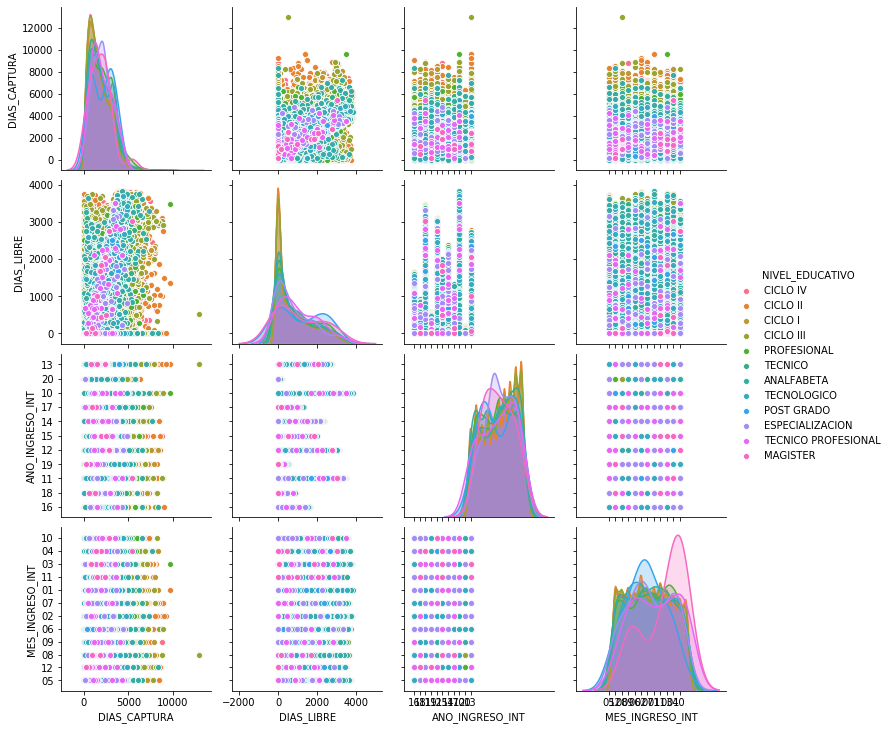

In [29]:
g = sns.pairplot(df_mj[['DIAS_CAPTURA', 'DIAS_LIBRE', 'DIAS_JUDICIALIZACION', 
                        'ANO_INGRESO_INT', 'MES_INGRESO_INT', 'NIVEL_EDUCATIVO']],
                 hue = 'NIVEL_EDUCATIVO') 

## 5. Survival analysis on days out of jail 

In [30]:
df_km = df_mj[['INTERNOEN', 'FECHA_INGRESO', 'DIAS_LIBRE', 'CENSURADO_LIBRES', 'ANO_INGRESO_INT', 'NUMERO_REINCIDENCIAS']].groupby('INTERNOEN').apply(lambda x: x.sort_values('FECHA_INGRESO', ascending = False).tail(1)).reset_index(drop = True)

In [31]:
A = df_mj[['INTERNOEN', 'FECHA_INGRESO']].apply(lambda x: x['INTERNOEN'] +  str(x['FECHA_INGRESO']), axis = 1)
B = df_km[['INTERNOEN', 'FECHA_INGRESO']].apply(lambda x: x['INTERNOEN'] + str(x['FECHA_INGRESO']), axis = 1)

diff = set(A).difference(set(B))
where_diff = A.isin(diff)

df_kmkm = df_mj.loc[where_diff, ['INTERNOEN', 'FECHA_INGRESO', 'DIAS_LIBRE', 'CENSURADO_LIBRES', 'ANO_INGRESO_INT', 'NUMERO_REINCIDENCIAS']].groupby('INTERNOEN').apply(lambda x: x.sort_values('FECHA_INGRESO', ascending = False).tail(1)).reset_index(drop = True)

C = df_kmkm[['INTERNOEN', 'FECHA_INGRESO']].apply(lambda x: x['INTERNOEN'] + str(x['FECHA_INGRESO']), axis = 1)

diff = diff.difference(set(C))
where_diff = A.isin(diff)

df_kmkmkm = df_mj.loc[where_diff, ['INTERNOEN', 'FECHA_INGRESO', 'DIAS_LIBRE', 'CENSURADO_LIBRES', 'ANO_INGRESO_INT', 'NUMERO_REINCIDENCIAS']].groupby('INTERNOEN').apply(lambda x: x.sort_values('FECHA_INGRESO', ascending = False).tail(1)).reset_index(drop = True)

D = df_kmkmkm[['INTERNOEN', 'FECHA_INGRESO']].apply(lambda x: x['INTERNOEN'] + str(x['FECHA_INGRESO']), axis = 1)

diff = diff.difference(set(D))
where_diff = A.isin(diff)

df_kmkmkmkm = df_mj.loc[where_diff, ['INTERNOEN', 'FECHA_INGRESO', 'DIAS_LIBRE', 'CENSURADO_LIBRES', 'ANO_INGRESO_INT', 'NUMERO_REINCIDENCIAS']].groupby('INTERNOEN').apply(lambda x: x.sort_values('FECHA_INGRESO', ascending = False).tail(1)).reset_index(drop = True)

E = df_kmkmkmkm[['INTERNOEN', 'FECHA_INGRESO']].apply(lambda x: x['INTERNOEN'] + str(x['FECHA_INGRESO']), axis = 1)

diff = diff.difference(set(E))
where_diff = A.isin(diff)

df_kmkmkmkmkm = df_mj.loc[where_diff, ['INTERNOEN', 'FECHA_INGRESO', 'DIAS_LIBRE', 'CENSURADO_LIBRES', 'ANO_INGRESO_INT', 'NUMERO_REINCIDENCIAS']].groupby('INTERNOEN').apply(lambda x: x.sort_values('FECHA_INGRESO', ascending = False).tail(1)).reset_index(drop = True)

In [33]:
import plotly.graph_objects as go

fig = go.Figure()

for i in [0, 1]:
    kmf = KaplanMeierFitter()
    kmf.fit(df_km.loc[df_km['NUMERO_REINCIDENCIAS']>i,'DIAS_LIBRE'], df_km.loc[df_km['NUMERO_REINCIDENCIAS']>i, 'CENSURADO_LIBRES'])
    
    if i == 0:
        name= 'Días fuera de la cárcel (95% IC)'
        fillcolor='rgba(0,176,246,0.2)'
        line_color='rgba(255,255,255,0)' 
        line_color_l='rgb(0,176,246)'
    else:
        name = 'Días fuera de la cárcel sólo con reincidentes (95% IC)'
        fillcolor='rgba(231,107,243,0.2)'
        line_color='rgba(255,255,255,0)'
        line_color_l='rgb(231,107,243)'

    df = kmf.survival_function_.reset_index()
    df.columns = ['Dias', 'Probabilidad de pasar más días afuera']

    df_interval = kmf.confidence_interval_survival_function_.reset_index()
    df_interval.columns = ['Dias', 'lwr', 'upr']

    fig.add_trace(go.Scatter(
        x=list(df_interval.Dias)+list(df_interval.Dias)[::-1],
        y=list(df_interval.upr)+list(df_interval.lwr)[::-1],
        fill='toself',
        fillcolor=fillcolor,
        line_color=line_color,
        showlegend=False,
        name=name,
    ))
    fig.add_trace(go.Scatter(
        x=df['Dias'],
        y=df['Probabilidad de pasar más días afuera'],
        line_color=line_color_l,
        name=name,
    ))

fig.update_layout(
    xaxis_title ="Días",
    yaxis_title = "P(t > T)",
    title = 'Días entre la primera y segunda reincidencia',
    font=dict(
        family="Courier New, monospace",
        size=18,
        color="#7f7f7f"
    )
)

fig.update_traces(mode='lines')
fig.show()

In [34]:
fig = go.Figure()

for i in [0, 2]:
    kmf = KaplanMeierFitter()
    kmf.fit(df_kmkm.loc[df_kmkm['NUMERO_REINCIDENCIAS']>i,'DIAS_LIBRE'], df_kmkm.loc[df_kmkm['NUMERO_REINCIDENCIAS']>i, 'CENSURADO_LIBRES'])
    
    if i == 0:
        name= 'Días fuera de la cárcel (95% IC)'
        fillcolor='rgba(0,176,246,0.2)'
        line_color='rgba(255,255,255,0)' 
        line_color_l='rgb(0,176,246)'
    else:
        name = 'Días fuera de la cárcel sólo con reincidentes (95% IC)'
        fillcolor='rgba(231,107,243,0.2)'
        line_color='rgba(255,255,255,0)'
        line_color_l='rgb(231,107,243)'

    df = kmf.survival_function_.reset_index()
    df.columns = ['Dias', 'Probabilidad de pasar más días afuera']

    df_interval = kmf.confidence_interval_survival_function_.reset_index()
    df_interval.columns = ['Dias', 'lwr', 'upr']

    fig.add_trace(go.Scatter(
        x=list(df_interval.Dias)+list(df_interval.Dias)[::-1],
        y=list(df_interval.upr)+list(df_interval.lwr)[::-1],
        fill='toself',
        fillcolor=fillcolor,
        line_color=line_color,
        showlegend=False,
        name=name,
    ))
    fig.add_trace(go.Scatter(
        x=df['Dias'],
        y=df['Probabilidad de pasar más días afuera'],
        line_color=line_color_l,
        name=name,
    ))

fig.update_layout(
    xaxis_title ="Días",
    yaxis_title = "P(t > T)",
    title = 'Días entre la segunda y tercera reincidencia',
    font=dict(
        family="Courier New, monospace",
        size=18,
        color="#7f7f7f"
    )
)

fig.update_traces(mode='lines')
fig.show()

In [35]:
fig = go.Figure()

for i in [0, 3]:
    kmf = KaplanMeierFitter()
    kmf.fit(df_kmkmkm.loc[df_kmkmkm['NUMERO_REINCIDENCIAS']>i,'DIAS_LIBRE'], df_kmkmkm.loc[df_kmkmkm['NUMERO_REINCIDENCIAS']>i, 'CENSURADO_LIBRES'])
    
    if i == 0:
        name= 'Días fuera de la cárcel (95% IC)'
        fillcolor='rgba(0,176,246,0.2)'
        line_color='rgba(255,255,255,0)' 
        line_color_l='rgb(0,176,246)'
    else:
        name = 'Días fuera de la cárcel sólo con reincidentes (95% IC)'
        fillcolor='rgba(231,107,243,0.2)'
        line_color='rgba(255,255,255,0)'
        line_color_l='rgb(231,107,243)'

    df = kmf.survival_function_.reset_index()
    df.columns = ['Dias', 'Probabilidad de pasar más días afuera']

    df_interval = kmf.confidence_interval_survival_function_.reset_index()
    df_interval.columns = ['Dias', 'lwr', 'upr']

    fig.add_trace(go.Scatter(
        x=list(df_interval.Dias)+list(df_interval.Dias)[::-1],
        y=list(df_interval.upr)+list(df_interval.lwr)[::-1],
        fill='toself',
        fillcolor=fillcolor,
        line_color=line_color,
        showlegend=False,
        name=name,
    ))
    fig.add_trace(go.Scatter(
        x=df['Dias'],
        y=df['Probabilidad de pasar más días afuera'],
        line_color=line_color_l,
        name=name,
    ))

fig.update_layout(
    xaxis_title ="Días",
    yaxis_title = "P(t > T)",
    title = 'Días entre la tercera y cuarta reincidencia',
    font=dict(
        family="Courier New, monospace",
        size=18,
        color="#7f7f7f"
    )
)

fig.update_traces(mode='lines')
fig.show()

In [36]:
fig = go.Figure()

for i in [0, 4]:
    kmf = KaplanMeierFitter()
    kmf.fit(df_kmkmkm.loc[df_kmkmkm['NUMERO_REINCIDENCIAS']>i,'DIAS_LIBRE'], df_kmkmkm.loc[df_kmkmkm['NUMERO_REINCIDENCIAS']>i, 'CENSURADO_LIBRES'])
    
    if i == 0:
        name= 'Días fuera de la cárcel (95% IC)'
        fillcolor='rgba(0,176,246,0.2)'
        line_color='rgba(255,255,255,0)' 
        line_color_l='rgb(0,176,246)'
    else:
        name = 'Días fuera de la cárcel sólo con reincidentes (95% IC)'
        fillcolor='rgba(231,107,243,0.2)'
        line_color='rgba(255,255,255,0)'
        line_color_l='rgb(231,107,243)'

    df = kmf.survival_function_.reset_index()
    df.columns = ['Dias', 'Probabilidad de pasar más días afuera']

    df_interval = kmf.confidence_interval_survival_function_.reset_index()
    df_interval.columns = ['Dias', 'lwr', 'upr']

    fig.add_trace(go.Scatter(
        x=list(df_interval.Dias)+list(df_interval.Dias)[::-1],
        y=list(df_interval.upr)+list(df_interval.lwr)[::-1],
        fill='toself',
        fillcolor=fillcolor,
        line_color=line_color,
        showlegend=False,
        name=name,
    ))
    fig.add_trace(go.Scatter(
        x=df['Dias'],
        y=df['Probabilidad de pasar más días afuera'],
        line_color=line_color_l,
        name=name,
    ))

fig.update_layout(
    xaxis_title ="Días",
    yaxis_title = "P(t > T)",
    title = 'Días entre la cuarta y quinta reincidencia',
    font=dict(
        family="Courier New, monospace",
        size=18,
        color="#7f7f7f"
    )
)

fig.update_traces(mode='lines')
fig.show()

### Análisis de supervivencia y matching ¡INCOMPLETO!!!!!

In [37]:
import scipy.stats as stats
from sklearn.metrics import roc_auc_score
from sklearn.linear_model import LogisticRegression

In [38]:
df_mj['MES_INGRESO_INT'].astype('int64')
df_mj['ANO_INGRESO_INT'].astype('int64')

treat_df = df_mj.drop_duplicates('INTERNOEN')
treat_df = treat_df.loc[treat_df['ACTIVIDADES_ESTUDIO'] == 'SI', ['DIAS_LIBRE', 'EDAD', 'MES_INGRESO_INT', 'ANO_INGRESO_INT', 'DIAS_CONDENA', 'CENSURADO_LIBRES', 'NUMERO_REINCIDENCIAS']]

untreat_df = df_mj[(df_mj['ACTIVIDADES_TRABAJO'] == 'NO') & (df_mj['ACTIVIDADES_ESTUDIO'] == 'NO') & (df_mj['ACTIVIDADES_ENSEÑANZA'] == 'NO')]
untreat_df = untreat_df.loc[untreat_df['INTERNOEN'].isin(set(untreat_df['INTERNOEN']).difference(set(treat_df))), ['DIAS_LIBRE', 'EDAD', 'MES_INGRESO_INT', 'ANO_INGRESO_INT', 'DIAS_CONDENA', 'CENSURADO_LIBRES', 'NUMERO_REINCIDENCIAS']]

dummies_df = pd.get_dummies(df_mj[['ESTADO', 'TENTATIVA', 'AGRAVADO', 'CALIFICADO', 'GENERO', 
                      'REGIONAL', 'ESTADO_INGRESO', 'NIVEL_EDUCATIVO', 'HIJOS_MENORES', 'ESTADO_CIVIL']], drop_first = True)

dummies_df.columns = [string.replace(' ', '_') for string in dummies_df.columns]
dummies_df.columns = [string.replace('(', '_')  for string in dummies_df.columns]
dummies_df.columns = [string.replace(')', '_')  for string in dummies_df.columns]
dummies_df.columns = [string.replace('-', '_')  for string in dummies_df.columns]

treat_df = treat_df.merge(dummies_df, right_index = True, left_index = True)
untreat_df = untreat_df.merge(dummies_df, right_index = True, left_index = True)

drops = list(set(treat_df.columns[np.where(treat_df.std() < 0.1)]).union(set(untreat_df.columns[np.where(untreat_df.std() == 0)])))

treat_df.drop(columns = drops, inplace = True)
untreat_df.drop(columns = drops, inplace = True)

treat_df['treatment'] = 1
untreat_df['treatment'] = 0

df_final = pd.concat([treat_df, untreat_df], axis =0)
df_final = df_final[~df_final['DIAS_CONDENA'].isnull()]

In [39]:
treatment = df_final.iloc[:,-1]
data = df_final.iloc[:, 1:-1]

In [40]:
logistic = LogisticRegression(solver = 'liblinear')
logistic.fit(data, treatment)

LogisticRegression(C=1.0, class_weight=None, dual=False, fit_intercept=True,
                   intercept_scaling=1, l1_ratio=None, max_iter=100,
                   multi_class='auto', n_jobs=None, penalty='l2',
                   random_state=None, solver='liblinear', tol=0.0001, verbose=0,
                   warm_start=False)

In [41]:
pscore = logistic.predict_proba(data)[:, 1]
pscore

array([0.98249392, 0.76020253, 0.82739918, ..., 0.74477595, 0.04435018,
       0.08262699])

In [42]:
roc_auc_score(treatment, pscore)

0.8702880174740587

In [43]:
mask = treatment == 0
pos_pscore = pscore[mask]
neg_pscore = pscore[~mask]
print('treatment count:', pos_pscore.shape)
print('control count:', neg_pscore.shape)

treatment count: (9132,)
control count: (39129,)


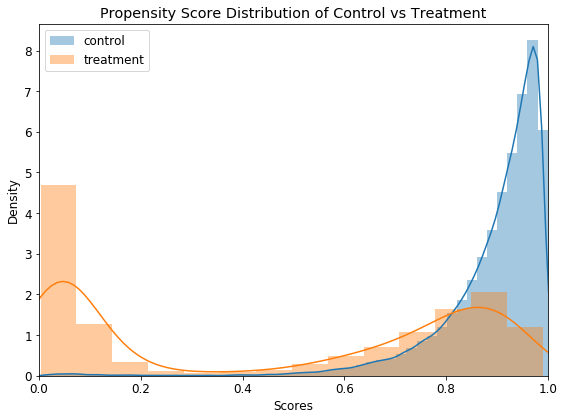

In [44]:
# change default style figure and font size
plt.rcParams['figure.figsize'] = 8, 6
plt.rcParams['font.size'] = 12

sns.distplot(neg_pscore, label='control')
sns.distplot(pos_pscore, label='treatment')
plt.xlim(0, 1)
plt.title('Propensity Score Distribution of Control vs Treatment')
plt.ylabel('Density')
plt.xlabel('Scores')
plt.legend()
plt.tight_layout()
plt.show()

In [45]:
def get_similar(pos_pscore: np.ndarray, neg_pscore: np.ndarray, topn: int=5, n_jobs: int=1):
    from sklearn.neighbors import NearestNeighbors

    knn = NearestNeighbors(n_neighbors=topn + 1, metric='euclidean', n_jobs=n_jobs)
    knn.fit(neg_pscore.reshape(-1, 1))

    distances, indices = knn.kneighbors(pos_pscore.reshape(-1, 1))
    sim_distances = distances[:, 1:]
    sim_indices = indices[:, 1:]
    return sim_distances, sim_indices


sim_distances, sim_indices = get_similar(pos_pscore, neg_pscore, topn=1)
sim_indices

array([[35916],
       [ 4484],
       [10867],
       ...,
       [ 3195],
       [17591],
       [38001]], dtype=int64)

In [46]:
caliper = 0.001
df_pos = df_final[mask][sim_distances < caliper]
df_neg = df_final[~mask].iloc[sim_indices[:, 0]][sim_distances < caliper]

In [47]:
df_pos.shape

(7870, 29)

In [48]:
for column in df_pos.columns:
    if df_pos[column].dtypes != 'object':
        statistic, pvalue = stats.ttest_ind(df_pos[column], df_neg[column], equal_var=False)
        if pvalue < 0.05:
            if column == 'DIAS_LIBRE':
                y_1 = df_pos[column].mean()
                y_2 = df_neg[column].mean()
                print(f'Treatment is significant, its TTE is {y_2 - y_1} with p-value {pvalue}')
            else:
                print(f'{column} is not balanced, its statistic is {statistic} with p-value {pvalue}')
        

Treatment is significant, its TTE is -134.39888485481993 with p-value 4.712354452537484e-17
DIAS_CONDENA is not balanced, its statistic is -7.080459922167675 with p-value 1.5001588221547726e-12
NUMERO_REINCIDENCIAS is not balanced, its statistic is 3.304336558411369 with p-value 0.0009541964247439517
ESTADO_Baja is not balanced, its statistic is -8.024076117601297 with p-value 1.1461358208810514e-15
TENTATIVA_S is not balanced, its statistic is 2.7595097913250926 with p-value 0.005795540463341338
AGRAVADO_S is not balanced, its statistic is -2.034315244467616 with p-value 0.04193655531787274
REGIONAL_NORTE is not balanced, its statistic is -2.4143330163946346 with p-value 0.015775397874303092
REGIONAL_ORIENTE is not balanced, its statistic is 5.0814934126029305 with p-value 3.788311535167109e-07
ESTADO_INGRESO_Espera_Traslado is not balanced, its statistic is 8.817648797841969 with p-value 1.4215345276404738e-18
ESTADO_INGRESO_Intramuros is not balanced, its statistic is 10.19383922653

In [49]:
df_pos['DIAS_LIBRE'].mean()
#untreat_df['DIAS_LIBRE'].mean()

1390.3980862595743

In [50]:
df_neg['DIAS_LIBRE'].mean()
#treat_df['DIAS_LIBRE'].mean()

1255.9992014047543

In [51]:
url="https://raw.githubusercontent.com/danncalle/ds4a-team6-1/master/retomintic/Data_UpdateJune13/shdi-4.0.csv"
df_shdi = pd.read_csv(url, sep=",",encoding="utf-8")

**Merging subnational human development index colombia (SHDI) data to Dataframe**

In [334]:
df_shdi.head()

,Variable,Category,Dtype,Decimals,RankOrder,Label,Shortdescr,Longdescr
0,iso_code,System,Str,NaN,NaN,NaN,ISO country code 3 digit,ISO country code 3 digit
1,country,System,Str,NaN,NaN,NaN,Country name,Country name
2,year,System,Int,0.0,NaN,NaN,Year of data collection,Year of data collection
3,GDLCODE,System,Str,NaN,NaN,NaN,Region code Global Data Lab,"Iso-code, level (t=total), regional division (..."
4,level,System,Str,NaN,NaN,NaN,Aggregation level,National or sub-national


In [56]:
url="https://raw.githubusercontent.com/danncalle/ds4a-team6-1/master/retomintic/Data_UpdateJune13/SHDI%20Colombia%204.0.csv"
df_shdi_col = pd.read_csv(url, sep=";",encoding="utf-8")

In [346]:
df_shdi_col[df_shdi_col.year >= 2009]
# df_shdi_col.head()
# df_shdi_col.region.values

,iso_code,country,year,GDLCODE,level,region,continent,shdi,healthindex,incindex,edindex,lifexp,gnic,esch,msch,pop
646,COL,Colombia,2009,COLr101,Subnat,Antioquia (incl Medellin),America,"0,731","0,861","0,713","0,636","75,96","11,248776","14,27","7,19","6,063101"
647,COL,Colombia,2009,COLr102,Subnat,Atlantico (incl Barranquilla),America,"0,737","0,849","0,705","0,67","75,16","10,609327","14,51",8,"2,152568"
648,COL,Colombia,2009,COLr103,Subnat,Bogota D.C.,America,"0,779","0,853","0,74","0,748","75,43","13,416773","15,62","9,41","7,464138"
649,COL,Colombia,2009,COLr104,Subnat,Bolivar (Sur and Norte),America,"0,708","0,838","0,659","0,642","74,44","7,851806","14,62","7,09","1,966705"
650,COL,Colombia,2009,COLr105,Subnat,Boyaca,America,"0,708","0,853","0,681","0,611","75,46","9,061926","14,58","6,19","1,402237"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
981,COL,Colombia,2018,COLr130,Subnat,Guainja,America,"0,664","0,884","0,582","0,569","77,48","4,700667","13,2","6,06","0,042698"
982,COL,Colombia,2018,COLr131,Subnat,Guaviare,America,"0,749","0,883","0,71","0,671","77,38","10,972033","14,99","7,65","0,067026"
983,COL,Colombia,2018,COLr132,Subnat,Vaupis,America,"0,635","0,797","0,527","0,611","71,82","3,283906","14,18","6,5","0,04518"
984,COL,Colombia,2018,COLr133,Subnat,Vichada,America,"0,748","0,886","0,722","0,653","77,58","11,945034","13,75","8,13","0,032272"


In [247]:
prueba = list(df_mj.DEPARTAMENTO)
prueba = [str(dept).lower() for dept in prueba]

dept_shdi = [str(dept).lower() for dept in list(df_shdi_col.region.unique())]

In [326]:
# print(dept_shdi)
# print(prueba)

In [327]:
import re
colombian_depts = list()
for elem in dept_shdi:
    new_elem = re.findall(r'([a-z].*)\(',elem)
    if len(new_elem)==0: 
        new_elem = re.findall(r'([a-z].*)',elem)
    colombian_depts = colombian_depts + new_elem

colombian_depts = [dept.strip() for dept in colombian_depts]
    
colombian_depts[2] = 'bogota'
colombian_depts[31] = 'vaupes'
colombian_depts[29] = 'guainia'
colombian_depts[23] = 'valle del cauca'
colombian_depts = colombian_depts[:-1]
len(colombian_depts)
# colombian_depts
# Son 33 porque tiene a bogota por separado

33

In [362]:
s = df_shdi_col.region
# print(colombian_depts)
for index, value in s.iteritems():
    value = str(value).lower().strip()
    for dept in colombian_depts:
        if "guain" in value:
            df_shdi_col.loc[index,"region"] = "guainia"
            break
        elif "valle del cauca" in value:
            df_shdi_col.loc[index,"region"] = "valle del cauca"
            break
        elif "vaup" in value:
            df_shdi_col.loc[index,"region"] = "vaupes"
            break
        elif "cali" in value:
            df_shdi_col.loc[index,"region"] = "valle del cauca"            
        elif dept in value:
            df_shdi_col.loc[index,"region"] = dept
            break
        else:
            continue
#             print(value, dept)
# df_shdi_col.region.unique()

In [328]:
print(len(prueba))
counter = 0
foreign = list()
for elem in prueba:
    flag = 0
    orig = elem
    elem = elem.strip()
    elem2 = ''.join(elem.split('-')[1:])
    if len(elem2)>0: elem = elem2
    if elem in colombian_depts: 
        prueba[prueba.index(orig)] = elem
    elif "bogota" in elem:
        prueba[prueba.index(orig)] = 'bogota'
    elif elem == "la guajira":
        prueba[prueba.index(orig)] = 'guajira'
    elif elem == "nariño":
        prueba[prueba.index(orig)] = 'narino'
    elif "san andres" in elem:
        prueba[prueba.index(orig)] = 'san andres'
    elif "pereira" in elem:
        prueba[prueba.index(orig)] = 'risaralda'
    elif "magdalena" in elem:
        prueba[prueba.index(orig)] = 'magdalena'
    elif "tolima" in elem:
        prueba[prueba.index(orig)] = 'tolima'
    elif "choco" in elem:
        prueba[prueba.index(orig)] = 'choco'
    elif "caldas" in elem:
        prueba[prueba.index(orig)] = 'caldas'
    elif "armenia" in elem:
        prueba[prueba.index(orig)] = 'quindio'
    else: foreign.append(elem)
# set(prueba)
# set(foreign)

142899


In [330]:
# df_mj

In [253]:
df_mj_reg = df_mj.copy()
df_mj_reg["DEPARTAMENTO"] = pd.Series(prueba)

In [331]:
# df_mj_reg.head()
# df_mj[df_mj["CIUDAD"]=="ARGELIA"]

In [323]:
s = df_mj_reg[df_mj_reg["DEPARTAMENTO"]=="republica de colombia"].CIUDAD
print(s)

for index, value in s.iteritems():
    if str(value).lower().strip() in colombian_depts:
        df_mj_reg.loc[index, 'DEPARTAMENTO'] = str(value).lower().strip()
    elif value == "REPUBLICA DE COLOMBIA":
        temp = df_mj_reg.loc[index, "DEPTO_ESTABLECIMIENTO"]
        if str(temp).lower().strip() in colombian_depts:
            df_mj_reg.loc[index, 'DEPARTAMENTO'] = str(temp).lower().strip()
        else:
            temp = df_mj_reg.loc[index, "ESTABLECIMIENTO"]
            if "IBAGUE" in temp:
                df_mj_reg.loc[index, 'DEPARTAMENTO'] = "tolima"
            else:
                print(df_mj_reg.loc[index, ["ESTABLECIMIENTO","DEPTO_ESTABLECIMIENTO","MPIO_ESTABLECIMIENTO"]])
    
    else:
        if value == "NARIÑO":
            df_mj_reg.loc[index, 'DEPARTAMENTO'] = "narino"
        else:
            print(index, value)


Series([], Name: CIUDAD, dtype: object)


In [450]:
foreign = list()
for dept in list(df_mj_reg.DEPARTAMENTO.unique()):
    if dept in colombian_depts: continue
    else:
        foreign.append(dept)

# print(foreign)
# df_mj_reg[df_mj_reg["DEPARTAMENTO"]=="republica de colombia"]
# df_mj.head()
# df_mj_reg.head()

In [385]:
df_shdi_col.head()
# df_shdi_col.year = df_shdi_col.year.apply(lambda x: int(str(x)[2:]))


,iso_code,country,year,GDLCODE,level,region,continent,shdi,healthindex,incindex,edindex,lifexp,gnic,esch,msch,pop
0,COL,Colombia,90,COLr101,Subnat,antioquia,America,"0,603","0,785","0,675","0,413","71,02","8,719078","8,63","5,2","4,092471"
1,COL,Colombia,90,COLr102,Subnat,atlantico,America,"0,631","0,785","0,66","0,484","71,02","7,910401","9,89","6,28","2,315525"
2,COL,Colombia,90,COLr103,Subnat,bogota,America,"0,673","0,778","0,709","0,552","70,59","10,950703","10,54","7,78","4,715131"
3,COL,Colombia,90,COLr104,Subnat,bolivar,America,"0,587","0,724","0,623","0,449","67,06","6,169956","9,39","5,65","1,122177"
4,COL,Colombia,90,COLr105,Subnat,boyaca,America,"0,567","0,804","0,603","0,375","72,24","5,404022","8,7",4,"1,556152"


In [447]:
df_shdi
df_mj.ANO_INGRESO_INT = df_mj.ANO_INGRESO_INT.astype('int64')
df_mj_reg.ANO_INGRESO_INT = df_mj_reg.ANO_INGRESO_INT.astype('int64')
# df_mj.ANO_INGRESO_INT

In [448]:
# df_mj[(df_mj.ESTADO_INGRESO != "Intramuros") & (df_mj.ESTADO_INGRESO != "Espera Traslado")].ESTADO_INGRESO.count()

In [449]:
# (df_mj["ESTADO_CIVIL"].values != np.nan).sum()
# df_mj.INTERNOEN.unique().shape

In [430]:
df_mj_shdi = pd.merge(df_mj_reg,df_shdi_col, left_on=["ANO_INGRESO_INT","DEPARTAMENTO"], right_on=["year","region"]).drop(columns=["continent","region","year","level","GDLCODE","iso_code"])

In [446]:
print(df_mj_shdi.shape)
df_mj_reg[df_mj_reg.ANO_INGRESO_INT>18]

(119900, 50)


,INTERNOEN,DELITO,TITULO_DELITO,SUBTITULO_DELITO,TENTATIVA,AGRAVADO,CALIFICADO,FECHA_INGRESO,FECHA_SALIDA,FECHA_CAPTURA,ANO_NACIMIENTO,EDAD,GENERO,ESTADO_CIVIL,PAIS_INTERNO,DEPARTAMENTO,CIUDAD,ESTADO_INGRESO,ACTIVIDADES_TRABAJO,ACTIVIDADES_ESTUDIO,ACTIVIDADES_ENSEÑANZA,NIVEL_EDUCATIVO,HIJOS_MENORES,CONDIC_EXPECIONAL,CODIGO_ESTABLECIMIENTO,ESTABLECIMIENTO,DEPTO_ESTABLECIMIENTO,MPIO_ESTABLECIMIENTO,REGIONAL,ESTADO,MES_INGRESO_INT,ANO_INGRESO_INT,DIAS_INGRESO,DIAS_SALIDA,DIAS_CAPTURA,DIAS_CONDENA,DIAS_JUDICIALIZACION,DIAS_LIBRE,CENSURADO_LIBRES,NUMERO_REINCIDENCIAS
4,FFFE667F85CF452DB70B955609103CB72ECA3EEB,FABRICACION TRAFICO Y PORTE DE ARMAS DE FUEGO ...,CONTRA LA SEGURIDAD PUBLICA,DE LOS DELITOS DE PELIGRO COMUN O QUE PUEDEN O...,N,N,N,2020-01-14,NaT,2019-12-16,1984,36,MASCULINO,UNION LIBRE,REPUBLICA DE COLOMBIA,norte de santander,CUCUTA-NORTE DE SANTANDER,Intramuros,SI,NO,NO,CICLO II,SI,NaN,4222,COMPLEJO CARCELARIO Y PENITENCIARIO METROPOLIT...,NORTE DE SANTANDER,CUCUTA,ORIENTE,Activo,01,20,178.65351,NaN,207.653517,NaN,29 days,0.00000,1,1
21,FFF7AEB8FA569C9038C6CE3A620A4D6C60FD7E72,HURTO,CONTRA EL PATRIMONIO ECONOMICO,DE LA ESTAFA,N,S,S,2019-03-13,2020-02-04,2019-02-27,1999,21,MASCULINO,NaN,REPUBLICA DE COLOMBIA,santander,BUCARAMANGA-SANTANDER,Detencion Domiciliaria,NO,SI,NO,CICLO III,SI,NaN,410,CPMS BUCARAMANGA (ERE),SANTANDER,BUCARAMANGA,ORIENTE,Baja,03,19,485.65351,157.653513,499.653517,328.0,14 days,157.65351,0,2
24,FFF5871301462D5364948DD4EBA6A59BCEC6E827,TRAFICO FABRICACION O PORTE DE ESTUPEFACIENTES,CONTRA LA SALUD PUBLICA,DE LAS AFECTACIONES A LA SALUD PUBLICA,N,N,N,2020-01-24,NaT,2015-10-23,1993,27,FEMENINO,SOLTERO(A),NaN,risaralda,BALBOA-RISARALDA,Prision Domiciliaria,NO,NO,NO,CICLO III,SI,NaN,620,RM PEREIRA,RISARALDA,PEREIRA,VIEJO CALDAS,Activo,01,20,168.65351,NaN,1722.653517,NaN,1554 days,0.00000,1,1
26,FFF5368EAC547E0EC82267C6B4A36E125BB23391,FRAUDE PROCESAL,CONTRA LA EFICAZ Y RECTA IMPARTICION DE JUSTICIA,DE LA FUGA DE PRESOS,N,N,N,2019-08-07,NaT,2019-05-07,1958,61,FEMENINO,CASADO(A),REPUBLICA DE COLOMBIA,santander,PALMAR-SANTANDER,Vigilancia Electronica,SI,NO,NO,CICLO III,SI,NaN,105,EPMSC DUITAMA,BOYACA,DUITAMA,CENTRAL,Activo,08,19,338.65351,NaN,430.653517,NaN,92 days,0.00000,1,1
33,FFF130EBB3CB958E4E62E76574A75386F2580817,FABRICACION TRAFICO Y PORTE DE ARMAS DE FUEGO ...,CONTRA LA SEGURIDAD PUBLICA,DE LOS DELITOS DE PELIGRO COMUN O QUE PUEDEN O...,N,N,N,2019-06-07,NaT,2014-08-31,1985,34,MASCULINO,UNION LIBRE,REPUBLICA DE COLOMBIA,atlantico,BARRANQUILLA-ATLANTICO,Intramuros,NO,SI,NO,CICLO II,SI,NaN,2422,COMPLEJO CARCELARIO Y PENITENCIARIO DE JAMUNDI...,VALLE DEL CAUCA,JAMUNDI,OCCIDENTE,Activo,06,19,399.65351,NaN,2140.653517,NaN,1741 days,0.00000,1,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
142884,0008649DEF36F510807D0AB58A84CF74E6083FBF,CONCIERTO PARA DELINQUIR,CONTRA LA SEGURIDAD PUBLICA,DE LOS DELITOS DE PELIGRO COMUN O QUE PUEDEN O...,N,N,N,2019-02-09,NaT,2020-04-02,1979,40,MASCULINO,UNION LIBRE,REPUBLICA DE COLOMBIA,norte de santander,CUCUTA-NORTE DE SANTANDER,Intramuros,SI,NO,NO,CICLO I,SI,NaN,4222,COMPLEJO CARCELARIO Y PENITENCIARIO METROPOLIT...,NORTE DE SANTANDER,CUCUTA,ORIENTE,Activo,02,19,517.65351,NaN,99.653517,NaN,-418 days,0.00000,1,2
142885,0008649DEF36F510807D0AB58A84CF74E6083FBF,HURTO,CONTRA EL PATRIMONIO ECONOMICO,DE LA ESTAFA,N,S,N,2019-02-09,NaT,2020-04-02,1979,40,MASCULINO,UNION LIBRE,REPUBLICA DE COLOMBIA,norte de santander,CUCUTA-NORTE DE SANTANDER,Intramuros,SI,NO,NO,CICLO I,SI,NaN,4222,COMPLEJO CARCELARIO Y PENITENCIARIO METROPOLIT...,NORTE DE SANTANDER,CUCUTA,ORIENTE,Activo,02,19,517.65351,NaN,99.653517,NaN,-418 days,0.00000,1,2
142890,0006F969D7EB7E2DD76A3F7F07D7116798FD51BF,FABRICACION TRAFICO Y PORTE DE ARMAS DE FUEGO ...,CONTRA LA SEGURIDAD PUBLICA,DE LOS DELITOS DE PELIGRO COMUN O QUE PUEDEN O...,N,N,N,2020-04-28,NaT,2017-06-27,1988,32,MASCULINO,SOLTERO(A),REPU